In [78]:
import numpy as np
from sklearn import preprocessing, model_selection,neighbors
import pandas as pd
from matplotlib import pyplot as plt
df = pd.read_csv('breast-cancer-wisconsin1.csv')
df.replace('?',-99999,inplace=True)
df.drop(['id'],1,inplace= True)
x = np.array(df.drop(['class'],1))
y = np.array(df['class'])
x_train, x_test,y_train,y_test = model_selection.train_test_split(x,y,test_size=0.2)
clf = neighbors.KNeighborsClassifier()
clf.fit(x_train,y_train)
acc = clf.score(x_test,y_test)
print(acc)
ex_measures = np.array([[4,9,1,9,1,2,3,9,9]])

prediction = clf.predict(ex_measures)
print(prediction)

0.9928571428571429
[4]


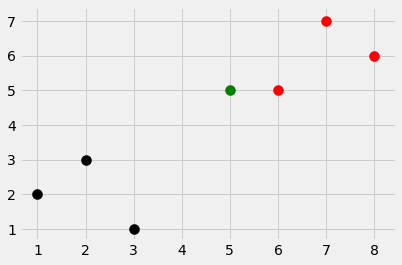

[[5.0, 'k']]
['k']
k


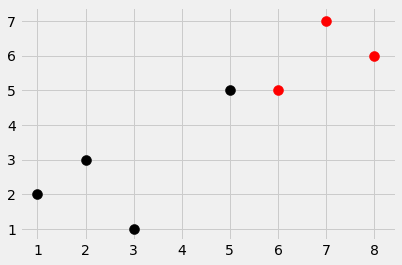

In [43]:
import matplotlib.pyplot as plt
import warnings
from matplotlib import style
import numpy as np
from  math import sqrt
from collections import Counter
style.use('fivethirtyeight')
datasets = {'k':[[1,2],[2,3],[3,1]] , 'r':[[6,5],[7,7],[8,6]] }
new_features = [5,5]
[[plt.scatter(ii[0],ii[1],s=100,color=i) for ii in datasets[i]] for i in datasets]
plt.scatter(new_features[0],new_features[1],s=100, color = 'g')
plt.show()
dist = []
def k_nearest_neighbors(data, predict, k=3):
    if len(data)>=k:
        warnings.warn('length of data is greater than k which means we can,t classify b/w more than k grps using k smallest dist')
     
            
  
        
    for grp in data:
        for features in data[grp]:
            euclid_dist = np.linalg.norm(np.array(features) - np.array(predict))
            dist.append([euclid_dist,grp])
            
            print(dist)
            votes = [i[1] for i in sorted(dist)[:k]]
            print(votes)
            votes_res = Counter(votes).most_common(1)[0][0]
            return votes_res

res = k_nearest_neighbors(datasets,new_features)
print(res)
[[plt.scatter(ii[0],ii[1],s=100,color=i) for ii in datasets[i]] for i in datasets]
plt.scatter(new_features[0],new_features[1],s=100, color = res)
plt.show()
                
            
                
                

In [ ]:
import matplotlib.pyplot as plt
import warnings
from matplotlib import style
import numpy as np
from  math import sqrt
import pandas as pd
import random
from collections import Counter
style.use('fivethirtyeight')

def k_nearest_neighbors(data, predict, k=3):
    if len(data) >= k:
        warnings.warn('K is set to a value less than total voting groups!')
        
    distances = []
    for group in data:
        for features in data[group]:
            euclidean_distance = np.linalg.norm(np.array(features)-np.array(predict))
            distances.append([euclidean_distance,group])
            
            print(distances)

    votes = [i[1] for i in sorted(distances)[:k]]
    print(votes)
    
    vote_result = Counter(votes).most_common(1)[0][0]
    return vote_result

df = pd.read_csv('breast-cancer-wisconsin1.csv')


df.replace('?',-99999,inplace=True)
df.drop(['id'],1,inplace= True)
full_data = df.astype(float).values.tolist()
random.shuffle(full_data)
print(full_data[:5])
train_set = {2:[] , 4:[]}
test_set = { 2:[] , 4:[]}
test_size =0.2
train_data = full_data[:-int(test_size*len(full_data))]
test_data = full_data[-int(test_size*len(full_data)):]
for i in train_data:
    a = int(i[-1])
    train_set[a].append(i[:-1])
    
for i in test_data:
    b = int(i[-1])
    test_set[b].append(i[:-1])
    
correct = 0
total = 0

for group in test_set:
    for data in test_set[group]:
        vote = k_nearest_neighbors(train_set, data, k=5)
        if group == vote:
            correct += 1
        total += 1
        
        
print('Accuracy:', correct/total)


[[8.0, 2.0, 4.0, 1.0, 5.0, 1.0, 5.0, 4.0, 4.0, 4.0], [1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 3.0, 1.0, 2.0], [5.0, 1.0, 1.0, 2.0, 2.0, 1.0, 2.0, 1.0, 1.0, 2.0], [4.0, 1.0, 1.0, 2.0, 2.0, 1.0, 2.0, 1.0, 1.0, 2.0], [9.0, 5.0, 5.0, 2.0, 2.0, 2.0, 5.0, 1.0, 1.0, 4.0]]
[[3.872983346207417, 2]]
[[3.872983346207417, 2], [1.4142135623730951, 2]]
[[3.872983346207417, 2], [1.4142135623730951, 2], [1.0, 2]]
[[3.872983346207417, 2], [1.4142135623730951, 2], [1.0, 2], [3.605551275463989, 2]]
[[3.872983346207417, 2], [1.4142135623730951, 2], [1.0, 2], [3.605551275463989, 2], [2.23606797749979, 2]]
[[3.872983346207417, 2], [1.4142135623730951, 2], [1.0, 2], [3.605551275463989, 2], [2.23606797749979, 2], [3.0, 2]]
[[3.872983346207417, 2], [1.4142135623730951, 2], [1.0, 2], [3.605551275463989, 2], [2.23606797749979, 2], [3.0, 2], [1.4142135623730951, 2]]
[[3.872983346207417, 2], [1.4142135623730951, 2], [1.0, 2], [3.605551275463989, 2], [2.23606797749979, 2], [3.0, 2], [1.4142135623730951, 2], [4.0, 2]]
[[

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[4.242640687119285, 2], [1.7320508075688772, 2], [1.4142135623730951, 2], [3.4641016151377544, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [2.23606797749979, 2], [4.358898943540674, 2], [3.0, 2], [3.605551275463989, 2], [2.8284271247461903, 2], [3.1622776601683795, 2], [3.3166247903554, 2], [0.0, 2], [2.8284271247461903, 2], [3.0, 2], [3.1622776601683795, 2], [2.8284271247461903, 2], [1.0, 2], [3.3166247903554, 2], [2.23606797749979, 2], [2.23606797749979, 2], [2.23606797749979, 2], [2.23606797749979, 2], [3.0, 2], [3.0, 2], [1.0, 2], [1.0, 2], [100000.000005, 2], [3.0, 2], [3.605551275463989, 2], [3.0, 2], [2.6457513110645907, 2], [8.660254037844387, 2], [1.4142135623730951, 2], [1.4142135623730951, 2], [3.1622776601683795, 2], [3.605551275463989, 2], [1.0, 2], [0.0, 2], [2.449489742783178, 2], [2.23606797749979, 2], [3.1622776601683795, 2], [2.8284271247461903, 2], [1.7320508075688772, 2], [3.7416573867739413, 2], [2.23606797749979, 2], [2.0, 2], [1.7320508075688772, 2], [1

[[4.69041575982343, 2], [5.196152422706632, 2], [4.69041575982343, 2], [6.0, 2], [5.477225575051661, 2], [4.242640687119285, 2], [4.123105625617661, 2], [4.795831523312719, 2], [4.58257569495584, 2], [4.123105625617661, 2], [2.8284271247461903, 2], [4.69041575982343, 2], [4.358898943540674, 2], [4.898979485566356, 2], [4.0, 2], [5.385164807134504, 2], [4.69041575982343, 2], [4.0, 2], [4.58257569495584, 2], [4.795831523312719, 2], [4.123105625617661, 2], [4.123105625617661, 2], [4.123105625617661, 2], [3.0, 2], [4.58257569495584, 2], [4.58257569495584, 2], [4.58257569495584, 2], [5.0, 2], [100004.0000649974, 2], [4.58257569495584, 2], [4.58257569495584, 2], [4.58257569495584, 2], [3.3166247903554, 2], [8.660254037844387, 2], [4.242640687119285, 2], [4.242640687119285, 2], [4.69041575982343, 2], [4.123105625617661, 2], [5.0, 2], [4.898979485566356, 2], [5.477225575051661, 2], [4.123105625617661, 2], [4.242640687119285, 2], [4.0, 2], [4.358898943540674, 2], [4.69041575982343, 2], [4.12310

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[2.6457513110645907, 2], [4.242640687119285, 2], [3.3166247903554, 2], [4.358898943540674, 2], [4.123105625617661, 2], [1.0, 2], [2.449489742783178, 2], [2.8284271247461903, 2], [1.4142135623730951, 2], [1.4142135623730951, 2], [3.872983346207417, 2], [1.7320508075688772, 2], [1.4142135623730951, 2], [3.3166247903554, 2], [1.7320508075688772, 2], [4.47213595499958, 2], [1.7320508075688772, 2], [1.7320508075688772, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [2.449489742783178, 2], [2.449489742783178, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [1.4142135623730951, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [3.4641016151377544, 2], [100000.00009, 2]]
[[2.6457513110645907, 2], [4.242640687119285, 2], [3.3166247903554, 2], [4.358898943540674, 2], [4.123105625617661, 2], [1.0, 2], [2.449489742783178, 2], [2.8284271247461903, 2], [1.4142135623730951, 2], [1.4142135623730951, 2], [3.872983346207417, 2], [1.7320508075688772, 2], [1.4142135623730951, 2], [3.316624

[[2.6457513110645907, 2], [4.242640687119285, 2], [3.3166247903554, 2], [4.358898943540674, 2], [4.123105625617661, 2], [1.0, 2], [2.449489742783178, 2], [2.8284271247461903, 2], [1.4142135623730951, 2], [1.4142135623730951, 2], [3.872983346207417, 2], [1.7320508075688772, 2], [1.4142135623730951, 2], [3.3166247903554, 2], [1.7320508075688772, 2], [4.47213595499958, 2], [1.7320508075688772, 2], [1.7320508075688772, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [2.449489742783178, 2], [2.449489742783178, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [1.4142135623730951, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [3.4641016151377544, 2], [100000.00009, 2], [3.1622776601683795, 2], [2.449489742783178, 2], [1.4142135623730951, 2], [2.8284271247461903, 2], [9.38083151964686, 2], [2.23606797749979, 2], [2.23606797749979, 2], [1.7320508075688772, 2], [1.4142135623730951, 2], [3.4641016151377544, 2], [3.3166247903554, 2], [4.358898943540674, 2], [2.449489742783178, 2], 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[5.0, 2], [1.4142135623730951, 2], [1.7320508075688772, 2], [4.58257569495584, 2], [3.0, 2], [4.58257569495584, 2], [2.8284271247461903, 2], [4.242640687119285, 2], [4.898979485566356, 2], [4.47213595499958, 2], [3.0, 2], [5.0, 2], [4.69041575982343, 2], [3.0, 2], [3.605551275463989, 2], [2.0, 2], [5.0, 2], [3.605551275463989, 2], [3.4641016151377544, 2], [2.449489742783178, 2], [2.8284271247461903, 2], [2.8284271247461903, 2], [2.8284271247461903, 2], [4.0, 2], [4.898979485566356, 2], [4.242640687119285, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [100000.00004, 2], [2.0, 2], [5.656854249492381, 2], [4.898979485566356, 2], [3.1622776601683795, 2], [8.831760866327848, 2], [3.0, 2], [3.0, 2], [5.0, 2], [4.47213595499958, 2], [3.1622776601683795, 2], [3.0, 2], [2.23606797749979, 2], [2.8284271247461903, 2], [4.58257569495584, 2], [3.605551275463989, 2], [2.449489742783178, 2], [5.0, 2], [3.7416573867739413, 2], [4.123105625617661, 2], [2.449489742783178, 2], [2.828427124746190

[[5.0, 2], [1.4142135623730951, 2], [1.7320508075688772, 2], [4.58257569495584, 2], [3.0, 2], [4.58257569495584, 2], [2.8284271247461903, 2], [4.242640687119285, 2], [4.898979485566356, 2], [4.47213595499958, 2], [3.0, 2], [5.0, 2], [4.69041575982343, 2], [3.0, 2], [3.605551275463989, 2], [2.0, 2], [5.0, 2], [3.605551275463989, 2], [3.4641016151377544, 2], [2.449489742783178, 2], [2.8284271247461903, 2], [2.8284271247461903, 2], [2.8284271247461903, 2], [4.0, 2], [4.898979485566356, 2], [4.242640687119285, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [100000.00004, 2], [2.0, 2], [5.656854249492381, 2], [4.898979485566356, 2], [3.1622776601683795, 2], [8.831760866327848, 2], [3.0, 2], [3.0, 2], [5.0, 2], [4.47213595499958, 2], [3.1622776601683795, 2], [3.0, 2], [2.23606797749979, 2], [2.8284271247461903, 2], [4.58257569495584, 2], [3.605551275463989, 2], [2.449489742783178, 2], [5.0, 2], [3.7416573867739413, 2], [4.123105625617661, 2], [2.449489742783178, 2], [2.8284271247461903

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[3.4641016151377544, 2], [4.795831523312719, 2], [4.0, 2], [5.830951894845301, 2], [5.477225575051661, 2], [3.1622776601683795, 2], [3.605551275463989, 2], [2.6457513110645907, 2], [3.605551275463989, 2], [3.0, 2], [3.7416573867739413, 2], [3.4641016151377544, 2], [3.0, 2], [4.69041575982343, 2], [3.1622776601683795, 2], [5.0, 2], [3.4641016151377544, 2], [3.1622776601683795, 2], [4.123105625617661, 2], [3.3166247903554, 2], [3.605551275463989, 2], [3.605551275463989, 2], [3.605551275463989, 2], [3.605551275463989, 2], [3.605551275463989, 2], [3.872983346207417, 2], [4.358898943540674, 2], [4.795831523312719, 2], [100002.0001249975, 2], [3.0, 2], [4.123105625617661, 2], [3.605551275463989, 2], [3.605551275463989, 2], [9.327379053088816, 2], [3.7416573867739413, 2], [3.7416573867739413, 2], [3.4641016151377544, 2], [3.0, 2], [4.795831523312719, 2], [4.69041575982343, 2], [4.898979485566356, 2], [3.605551275463989, 2], [3.1622776601683795, 2], [3.1622776601683795, 2], [4.79583152331271

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[3.0, 2], [4.69041575982343, 2], [3.872983346207417, 2], [4.58257569495584, 2], [4.123105625617661, 2], [2.23606797749979, 2], [2.8284271247461903, 2], [3.1622776601683795, 2], [2.8284271247461903, 2], [2.0, 2], [4.123105625617661, 2], [3.0, 2], [2.449489742783178, 2], [4.123105625617661, 2], [2.23606797749979, 2], [4.47213595499958, 2], [3.0, 2], [2.23606797749979, 2], [3.4641016151377544, 2], [3.1622776601683795, 2], [2.8284271247461903, 2], [2.8284271247461903, 2], [2.8284271247461903, 2], [4.0, 2], [2.8284271247461903, 2], [3.1622776601683795, 2], [3.7416573867739413, 2], [4.242640687119285, 2], [100000.00012, 2], [3.4641016151377544, 2], [3.4641016151377544, 2], [2.8284271247461903, 2], [3.1622776601683795, 2], [9.486832980505138, 2], [3.0, 2], [3.0, 2], [3.0, 2], [2.0, 2], [4.242640687119285, 2], [4.123105625617661, 2], [4.58257569495584, 2], [2.8284271247461903, 2], [2.23606797749979, 2], [2.23606797749979, 2], [4.69041575982343, 2], [1.0, 2], [2.449489742783178, 2], [3.0, 2],

[[2.23606797749979, 2], [4.242640687119285, 2], [3.3166247903554, 2], [5.0, 2], [4.58257569495584, 2], [1.0, 2], [2.0, 2], [2.449489742783178, 2], [2.0, 2], [0.0, 2], [3.605551275463989, 2], [2.23606797749979, 2], [1.4142135623730951, 2], [3.605551275463989, 2], [1.0, 2], [4.47213595499958, 2], [2.23606797749979, 2], [1.0, 2], [2.8284271247461903, 2], [3.1622776601683795, 2], [2.0, 2], [2.0, 2], [2.0, 2], [3.4641016151377544, 2], [2.0, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [3.7416573867739413, 2], [100000.0001, 2], [2.8284271247461903, 2], [3.4641016151377544, 2], [2.0, 2], [2.449489742783178, 2], [9.899494936611665, 2], [2.23606797749979, 2], [2.23606797749979, 2], [2.23606797749979, 2], [0.0, 2], [3.7416573867739413, 2], [3.605551275463989, 2], [4.58257569495584, 2], [2.0, 2], [1.0, 2], [1.0, 2], [4.242640687119285, 2], [2.23606797749979, 2], [1.4142135623730951, 2], [2.23606797749979, 2], [4.242640687119285, 2], [4.47213595499958, 2], [2.8284271247461903, 2], [2.44948

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[3.3166247903554, 2], [4.69041575982343, 2], [3.872983346207417, 2], [3.872983346207417, 2], [4.123105625617661, 2], [2.23606797749979, 2], [3.1622776601683795, 2], [3.1622776601683795, 2], [2.449489742783178, 2], [2.449489742783178, 2], [4.358898943540674, 2], [2.6457513110645907, 2], [2.449489742783178, 2], [3.872983346207417, 2], [2.6457513110645907, 2], [4.47213595499958, 2], [2.6457513110645907, 2], [2.6457513110645907, 2], [3.1622776601683795, 2], [3.1622776601683795, 2], [3.1622776601683795, 2], [3.1622776601683795, 2], [3.1622776601683795, 2], [3.7416573867739413, 2], [2.449489742783178, 2], [2.449489742783178, 2], [3.7416573867739413, 2], [4.0, 2], [100000.00011, 2], [3.7416573867739413, 2], [2.8284271247461903, 2], [2.449489742783178, 2], [3.4641016151377544, 2], [9.055385138137417, 2], [3.0, 2], [3.0, 2], [2.6457513110645907, 2], [2.449489742783178, 2], [4.0, 2], [3.872983346207417, 2], [4.358898943540674, 2], [3.1622776601683795, 2], [2.23606797749979, 2], [2.6457513110645

[[2.0, 2], [4.358898943540674, 2], [3.4641016151377544, 2], [5.0990195135927845, 2], [4.69041575982343, 2], [1.4142135623730951, 2], [2.23606797749979, 2], [2.6457513110645907, 2], [2.23606797749979, 2], [1.0, 2], [3.7416573867739413, 2], [2.0, 2], [1.0, 2], [3.7416573867739413, 2], [1.4142135623730951, 2], [4.58257569495584, 2], [2.0, 2], [1.4142135623730951, 2], [3.0, 2], [3.3166247903554, 2], [2.23606797749979, 2], [2.23606797749979, 2], [2.23606797749979, 2], [3.605551275463989, 2], [2.23606797749979, 2], [2.6457513110645907, 2], [3.3166247903554, 2], [3.872983346207417, 2], [100000.000105, 2], [3.0, 2], [3.605551275463989, 2], [2.23606797749979, 2], [3.0, 2], [10.14889156509222, 2], [2.449489742783178, 2], [2.449489742783178, 2], [2.0, 2], [1.0, 2], [3.872983346207417, 2], [3.7416573867739413, 2], [4.47213595499958, 2], [2.23606797749979, 2], [1.4142135623730951, 2], [1.4142135623730951, 2], [4.358898943540674, 2], [2.449489742783178, 2], [1.7320508075688772, 2], [2.44948974278317

[[2.0, 2], [4.358898943540674, 2], [3.4641016151377544, 2], [5.0990195135927845, 2], [4.69041575982343, 2], [1.4142135623730951, 2], [2.23606797749979, 2], [2.6457513110645907, 2], [2.23606797749979, 2], [1.0, 2], [3.7416573867739413, 2], [2.0, 2], [1.0, 2], [3.7416573867739413, 2], [1.4142135623730951, 2], [4.58257569495584, 2], [2.0, 2], [1.4142135623730951, 2], [3.0, 2], [3.3166247903554, 2], [2.23606797749979, 2], [2.23606797749979, 2], [2.23606797749979, 2], [3.605551275463989, 2], [2.23606797749979, 2], [2.6457513110645907, 2], [3.3166247903554, 2], [3.872983346207417, 2], [100000.000105, 2], [3.0, 2], [3.605551275463989, 2], [2.23606797749979, 2], [3.0, 2], [10.14889156509222, 2], [2.449489742783178, 2], [2.449489742783178, 2], [2.0, 2], [1.0, 2], [3.872983346207417, 2], [3.7416573867739413, 2], [4.47213595499958, 2], [2.23606797749979, 2], [1.4142135623730951, 2], [1.4142135623730951, 2], [4.358898943540674, 2], [2.449489742783178, 2], [1.7320508075688772, 2], [2.44948974278317

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[3.7416573867739413, 2], [4.58257569495584, 2], [3.7416573867739413, 2], [4.242640687119285, 2], [4.242640687119285, 2], [2.449489742783178, 2], [3.605551275463989, 2], [3.3166247903554, 2], [2.23606797749979, 2], [3.0, 2], [4.69041575982343, 2], [2.449489742783178, 2], [2.6457513110645907, 2], [3.7416573867739413, 2], [3.1622776601683795, 2], [4.795831523312719, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [3.0, 2], [3.3166247903554, 2], [3.605551275463989, 2], [3.605551275463989, 2], [3.605551275463989, 2], [3.605551275463989, 2], [2.23606797749979, 2], [3.3166247903554, 2], [3.872983346207417, 2], [3.872983346207417, 2], [100000.000105, 2], [3.605551275463989, 2], [2.23606797749979, 2], [2.23606797749979, 2], [3.872983346207417, 2], [8.888194417315589, 2], [3.1622776601683795, 2], [3.1622776601683795, 2], [2.449489742783178, 2], [3.0, 2], [3.872983346207417, 2], [3.7416573867739413, 2], [4.47213595499958, 2], [3.605551275463989, 2], [2.449489742783178, 2], [3.1622776601683

[[4.242640687119285, 2], [1.7320508075688772, 2], [1.4142135623730951, 2], [3.4641016151377544, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [2.23606797749979, 2], [4.358898943540674, 2], [3.0, 2], [3.605551275463989, 2], [2.8284271247461903, 2], [3.1622776601683795, 2], [3.3166247903554, 2], [0.0, 2], [2.8284271247461903, 2], [3.0, 2], [3.1622776601683795, 2], [2.8284271247461903, 2], [1.0, 2], [3.3166247903554, 2], [2.23606797749979, 2], [2.23606797749979, 2], [2.23606797749979, 2], [2.23606797749979, 2], [3.0, 2], [3.0, 2], [1.0, 2], [1.0, 2], [100000.000005, 2], [3.0, 2], [3.605551275463989, 2], [3.0, 2], [2.6457513110645907, 2], [8.660254037844387, 2], [1.4142135623730951, 2], [1.4142135623730951, 2], [3.1622776601683795, 2], [3.605551275463989, 2], [1.0, 2], [0.0, 2], [2.449489742783178, 2], [2.23606797749979, 2], [3.1622776601683795, 2], [2.8284271247461903, 2], [1.7320508075688772, 2], [3.7416573867739413, 2], [2.23606797749979, 2], [2.0, 2], [1.7320508075688772, 2], [1

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[2.23606797749979, 2], [4.242640687119285, 2], [3.3166247903554, 2], [5.0, 2], [4.58257569495584, 2], [1.0, 2], [2.0, 2], [2.449489742783178, 2], [2.0, 2], [0.0, 2], [3.605551275463989, 2], [2.23606797749979, 2], [1.4142135623730951, 2], [3.605551275463989, 2], [1.0, 2], [4.47213595499958, 2], [2.23606797749979, 2], [1.0, 2], [2.8284271247461903, 2], [3.1622776601683795, 2], [2.0, 2], [2.0, 2], [2.0, 2], [3.4641016151377544, 2], [2.0, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [3.7416573867739413, 2], [100000.0001, 2], [2.8284271247461903, 2], [3.4641016151377544, 2], [2.0, 2], [2.449489742783178, 2], [9.899494936611665, 2], [2.23606797749979, 2], [2.23606797749979, 2], [2.23606797749979, 2], [0.0, 2], [3.7416573867739413, 2], [3.605551275463989, 2], [4.58257569495584, 2], [2.0, 2], [1.0, 2], [1.0, 2], [4.242640687119285, 2], [2.23606797749979, 2], [1.4142135623730951, 2], [2.23606797749979, 2], [4.242640687119285, 2], [4.47213595499958, 2], [2.8284271247461903, 2], [2.4494

[[2.23606797749979, 2], [4.242640687119285, 2], [3.3166247903554, 2], [5.0, 2], [4.58257569495584, 2], [1.0, 2], [2.0, 2], [2.449489742783178, 2], [2.0, 2], [0.0, 2], [3.605551275463989, 2], [2.23606797749979, 2], [1.4142135623730951, 2], [3.605551275463989, 2], [1.0, 2], [4.47213595499958, 2], [2.23606797749979, 2], [1.0, 2], [2.8284271247461903, 2], [3.1622776601683795, 2], [2.0, 2], [2.0, 2], [2.0, 2], [3.4641016151377544, 2], [2.0, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [3.7416573867739413, 2], [100000.0001, 2], [2.8284271247461903, 2], [3.4641016151377544, 2], [2.0, 2], [2.449489742783178, 2], [9.899494936611665, 2], [2.23606797749979, 2], [2.23606797749979, 2], [2.23606797749979, 2], [0.0, 2], [3.7416573867739413, 2], [3.605551275463989, 2], [4.58257569495584, 2], [2.0, 2], [1.0, 2], [1.0, 2], [4.242640687119285, 2], [2.23606797749979, 2], [1.4142135623730951, 2], [2.23606797749979, 2], [4.242640687119285, 2], [4.47213595499958, 2], [2.8284271247461903, 2], [2.44948

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[2.6457513110645907, 2], [3.1622776601683795, 2], [2.23606797749979, 2], [4.123105625617661, 2], [3.605551275463989, 2], [1.0, 2], [1.4142135623730951, 2], [2.8284271247461903, 2], [1.4142135623730951, 2], [1.4142135623730951, 2], [3.0, 2], [1.7320508075688772, 2], [1.4142135623730951, 2], [2.23606797749979, 2], [1.0, 2], [3.7416573867739413, 2], [1.7320508075688772, 2], [1.0, 2], [1.4142135623730951, 2], [2.8284271247461903, 2], [1.4142135623730951, 2], [1.4142135623730951, 2], [1.4142135623730951, 2], [2.449489742783178, 2], [1.4142135623730951, 2], [2.0, 2], [2.0, 2], [2.449489742783178, 2], [100000.00005, 2], [2.449489742783178, 2], [2.8284271247461903, 2], [1.4142135623730951, 2], [2.0, 2], [9.273618495495704, 2], [1.0, 2], [1.0, 2], [1.7320508075688772, 2], [1.4142135623730951, 2], [2.449489742783178, 2], [2.23606797749979, 2], [3.605551275463989, 2], [1.4142135623730951, 2], [1.0, 2], [1.0, 2], [3.1622776601683795, 2], [2.23606797749979, 2], [0.0, 2], [1.0, 2], [3.1622776601683

[[2.23606797749979, 2], [4.242640687119285, 2], [3.3166247903554, 2], [4.795831523312719, 2], [4.58257569495584, 2], [1.0, 2], [2.449489742783178, 2], [2.8284271247461903, 2], [1.4142135623730951, 2], [1.4142135623730951, 2], [3.872983346207417, 2], [1.0, 2], [0.0, 2], [3.3166247903554, 2], [1.7320508075688772, 2], [4.69041575982343, 2], [1.0, 2], [1.7320508075688772, 2], [2.449489742783178, 2], [3.4641016151377544, 2], [2.449489742783178, 2], [2.449489742783178, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [1.4142135623730951, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [3.4641016151377544, 2], [100000.00009, 2], [3.1622776601683795, 2], [2.8284271247461903, 2], [1.4142135623730951, 2], [3.1622776601683795, 2], [9.899494936611665, 2], [2.23606797749979, 2], [2.23606797749979, 2], [1.0, 2], [1.4142135623730951, 2], [3.4641016151377544, 2], [3.3166247903554, 2], [4.358898943540674, 2], [2.449489742783178, 2], [1.0, 2], [1.7320508075688772, 2], [4.242640687119285, 2], [2

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[3.0, 2], [4.242640687119285, 2], [3.3166247903554, 2], [4.58257569495584, 2], [4.58257569495584, 2], [1.0, 2], [2.8284271247461903, 2], [3.1622776601683795, 2], [0.0, 2], [2.0, 2], [4.123105625617661, 2], [1.0, 2], [1.4142135623730951, 2], [3.0, 2], [2.23606797749979, 2], [4.898979485566356, 2], [1.0, 2], [2.23606797749979, 2], [2.0, 2], [3.7416573867739413, 2], [2.8284271247461903, 2], [2.8284271247461903, 2], [2.8284271247461903, 2], [2.8284271247461903, 2], [0.0, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [3.1622776601683795, 2], [100000.00008, 2], [3.4641016151377544, 2], [2.0, 2], [0.0, 2], [3.1622776601683795, 2], [9.486832980505138, 2], [2.23606797749979, 2], [2.23606797749979, 2], [1.0, 2], [2.0, 2], [3.1622776601683795, 2], [3.0, 2], [4.58257569495584, 2], [2.8284271247461903, 2], [1.0, 2], [2.23606797749979, 2], [4.242640687119285, 2], [2.23606797749979, 2], [1.4142135623730951, 2], [1.0, 2], [4.242640687119285, 2], [4.0, 2], [2.0, 2], [3.1622776601683795, 2], [4

[[3.0, 2], [4.242640687119285, 2], [3.3166247903554, 2], [4.58257569495584, 2], [4.58257569495584, 2], [1.0, 2], [2.8284271247461903, 2], [3.1622776601683795, 2], [0.0, 2], [2.0, 2], [4.123105625617661, 2], [1.0, 2], [1.4142135623730951, 2], [3.0, 2], [2.23606797749979, 2], [4.898979485566356, 2], [1.0, 2], [2.23606797749979, 2], [2.0, 2], [3.7416573867739413, 2], [2.8284271247461903, 2], [2.8284271247461903, 2], [2.8284271247461903, 2], [2.8284271247461903, 2], [0.0, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [3.1622776601683795, 2], [100000.00008, 2], [3.4641016151377544, 2], [2.0, 2], [0.0, 2], [3.1622776601683795, 2], [9.486832980505138, 2], [2.23606797749979, 2], [2.23606797749979, 2], [1.0, 2], [2.0, 2], [3.1622776601683795, 2], [3.0, 2], [4.58257569495584, 2], [2.8284271247461903, 2], [1.0, 2], [2.23606797749979, 2], [4.242640687119285, 2], [2.23606797749979, 2], [1.4142135623730951, 2], [1.0, 2], [4.242640687119285, 2], [4.0, 2], [2.0, 2], [3.1622776601683795, 2], [4.

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[100000.00078, 2], [100000.000755, 2], [100000.00074999999, 2], [100000.0005, 2], [100000.00074, 2], [100000.00084, 2], [100000.000825, 2], [100000.000665, 2], [100000.000825, 2], [100000.000865, 2], [100002.0008199836, 2], [100000.00087999999, 2], [100000.00089499999, 2], [100000.00078, 2], [100000.00084, 2], [100000.000705, 2], [100000.00087999999, 2], [100000.00084, 2], [100000.000785, 2], [100000.000665, 2], [100000.000825, 2], [100000.000825, 2], [100000.000825, 2], [100002.0007849843, 2], [100000.000825, 2], [100000.000735, 2], [100000.000795, 2], [100000.000705, 2], [12.529964086141668, 2], [100000.000745, 2], [100001.00070999289, 2], [100000.000825, 2], [100001.0007799922, 2], [100004.0001649934, 2], [100000.0008, 2], [100000.0008, 2], [100000.00087999999, 2], [100000.000865, 2], [100000.000705, 2], [100000.00078, 2], [100000.00073, 2], [100000.000825, 2], [100000.00084, 2], [100000.00084, 2], [100001.00079999199, 2], [100000.00078, 2], [100000.00081499999, 2], [100000.0008, 

[[2.23606797749979, 2], [4.242640687119285, 2], [3.3166247903554, 2], [5.0, 2], [4.58257569495584, 2], [1.0, 2], [2.0, 2], [2.449489742783178, 2], [2.0, 2], [0.0, 2], [3.605551275463989, 2], [2.23606797749979, 2], [1.4142135623730951, 2], [3.605551275463989, 2], [1.0, 2], [4.47213595499958, 2], [2.23606797749979, 2], [1.0, 2], [2.8284271247461903, 2], [3.1622776601683795, 2], [2.0, 2], [2.0, 2], [2.0, 2], [3.4641016151377544, 2], [2.0, 2], [2.449489742783178, 2], [3.1622776601683795, 2], [3.7416573867739413, 2], [100000.0001, 2], [2.8284271247461903, 2], [3.4641016151377544, 2], [2.0, 2], [2.449489742783178, 2], [9.899494936611665, 2], [2.23606797749979, 2], [2.23606797749979, 2], [2.23606797749979, 2], [0.0, 2], [3.7416573867739413, 2], [3.605551275463989, 2], [4.58257569495584, 2], [2.0, 2], [1.0, 2], [1.0, 2], [4.242640687119285, 2], [2.23606797749979, 2], [1.4142135623730951, 2], [2.23606797749979, 2], [4.242640687119285, 2], [4.47213595499958, 2], [2.8284271247461903, 2], [2.44948

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[100000.00005, 2], [100000.000105, 2], [100000.00007, 2], [100000.00009, 2], [100000.00008, 2], [100000.00002, 2], [100000.000045, 2], [100000.000055, 2], [100000.000025, 2], [100000.000025, 2], [100002.0000699986, 2], [100000.00003, 2], [100000.000025, 2], [100000.00007, 2], [100000.00003, 2], [100000.000105, 2], [100000.00003, 2], [100000.00003, 2], [100000.000045, 2], [100000.000055, 2], [100000.000045, 2], [100000.000045, 2], [100000.000045, 2], [100002.0000449991, 2], [100000.000025, 2], [100000.000045, 2], [100000.000065, 2], [100000.000075, 2], [4.58257569495584, 2], [100000.000065, 2], [100001.0000299997, 2], [100000.000025, 2], [100001.0000499995, 2], [100004.0003449862, 2], [100000.00004, 2], [100000.00004, 2], [100000.00003, 2], [100000.000025, 2], [100000.000075, 2], [100000.00007, 2], [100000.0001, 2], [100000.000045, 2], [100000.00002, 2], [100000.00003, 2], [100001.000099999, 2], [100000.0, 2], [100000.000025, 2], [100000.00003, 2], [100000.000105, 2], [100000.000105, 

[[5.0990195135927845, 2], [6.082762530298219, 2], [5.830951894845301, 2], [3.4641016151377544, 2], [6.0, 2], [6.0, 2], [5.916079783099616, 2], [5.5677643628300215, 2], [5.916079783099616, 2], [6.244997998398398, 2], [6.324555320336759, 2], [6.164414002968976, 2], [6.244997998398398, 2], [5.656854249492381, 2], [6.0, 2], [6.082762530298219, 2], [6.164414002968976, 2], [6.0, 2], [5.5677643628300215, 2], [5.916079783099616, 2], [5.916079783099616, 2], [5.916079783099616, 2], [5.916079783099616, 2], [5.916079783099616, 2], [5.916079783099616, 2], [5.385164807134504, 2], [5.744562646538029, 2], [4.795831523312719, 2], [100000.000175, 2], [6.244997998398398, 2], [5.196152422706632, 2], [5.916079783099616, 2], [5.916079783099616, 2], [5.5677643628300215, 2], [5.656854249492381, 2], [5.656854249492381, 2], [6.164414002968976, 2], [6.244997998398398, 2], [4.795831523312719, 2], [5.656854249492381, 2], [6.0, 2], [5.916079783099616, 2], [6.0, 2], [6.0, 2], [6.082762530298219, 2], [6.0, 2], [5.744

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[100000.00011, 2], [100000.000075, 2], [100000.00006, 2], [100000.00005, 2], [100000.00003, 2], [100000.00007, 2], [100000.000065, 2], [100000.000115, 2], [100000.000065, 2], [100000.000085, 2], [100002.0000699986, 2], [100000.00007, 2], [100000.000075, 2], [100000.00005, 2], [100000.00007, 2], [100000.000075, 2], [100000.00007, 2], [100000.00007, 2], [100000.000045, 2], [100000.000065, 2], [100000.000065, 2], [100000.000065, 2], [100000.000065, 2], [100002.0000449991, 2], [100000.000065, 2], [100000.000075, 2], [100000.000055, 2], [100000.000055, 2], [3.605551275463989, 2], [100000.000085, 2], [100001.0000499995, 2], [100000.000065, 2], [100001.0000699993, 2], [100004.0002649894, 2], [100000.00005, 2], [100000.00005, 2], [100000.00007, 2], [100000.000085, 2], [100000.000055, 2], [100000.00005, 2], [100000.00006, 2], [100000.000065, 2], [100000.00007, 2], [100000.00007, 2], [100001.0000699993, 2], [100000.00003, 2], [100000.000055, 2], [100000.00005, 2], [100000.000075, 2], [100000.0

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[[10.0, 2], [7.280109889280518, 2], [7.745966692414834, 2], [5.656854249492381, 2], [6.324555320336759, 2], [9.797958971132712, 2], [8.774964387392123, 2], [9.433981132056603, 2], [9.643650760992955, 2], [10.04987562112089, 2], [8.48528137423857, 2], [9.797958971132712, 2], [9.9498743710662, 2], [7.745966692414834, 2], [9.38083151964686, 2], [6.708203932499369, 2], [9.797958971132712, 2], [9.38083151964686, 2], [8.306623862918075, 2], [7.681145747868608, 2], [8.774964387392123, 2], [8.774964387392123, 2], [8.774964387392123, 2], [8.54400374531753, 2], [9.643650760992955, 2], [8.660254037844387, 2], [7.937253933193772, 2], [7.54983443527075, 2], [100000.000265, 2], [8.54400374531753, 2], [9.0, 2], [9.643650760992955, 2], [8.774964387392123, 2], [6.855654600401044, 2], [8.48528137423857, 2], [8.48528137423857, 2], [9.797958971132712, 2], [10.04987562112089, 2], [7.54983443527075, 2], [7.745966692414834, 2], [6.48074069840786, 2], [8.774964387392123, 2], [9.797958971132712, 2], [9.380831

[[10.0, 2], [7.280109889280518, 2], [7.745966692414834, 2], [5.656854249492381, 2], [6.324555320336759, 2], [9.797958971132712, 2], [8.774964387392123, 2], [9.433981132056603, 2], [9.643650760992955, 2], [10.04987562112089, 2], [8.48528137423857, 2], [9.797958971132712, 2], [9.9498743710662, 2], [7.745966692414834, 2], [9.38083151964686, 2], [6.708203932499369, 2], [9.797958971132712, 2], [9.38083151964686, 2], [8.306623862918075, 2], [7.681145747868608, 2], [8.774964387392123, 2], [8.774964387392123, 2], [8.774964387392123, 2], [8.54400374531753, 2], [9.643650760992955, 2], [8.660254037844387, 2], [7.937253933193772, 2], [7.54983443527075, 2], [100000.000265, 2], [8.54400374531753, 2], [9.0, 2], [9.643650760992955, 2], [8.774964387392123, 2], [6.855654600401044, 2], [8.48528137423857, 2], [8.48528137423857, 2], [9.797958971132712, 2], [10.04987562112089, 2], [7.54983443527075, 2], [7.745966692414834, 2], [6.48074069840786, 2], [8.774964387392123, 2], [9.797958971132712, 2], [9.3808315

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[[5.196152422706632, 2], [2.449489742783178, 2], [2.6457513110645907, 2], [2.6457513110645907, 2], [2.6457513110645907, 2], [4.795831523312719, 2], [3.7416573867739413, 2], [4.898979485566356, 2], [4.69041575982343, 2], [5.0990195135927845, 2], [3.3166247903554, 2], [4.795831523312719, 2], [4.898979485566356, 2], [2.6457513110645907, 2], [4.358898943540674, 2], [2.449489742783178, 2], [4.795831523312719, 2], [4.358898943540674, 2], [3.1622776601683795, 2], [3.4641016151377544, 2], [3.7416573867739413, 2], [3.7416573867739413, 2], [3.7416573867739413, 2], [3.1622776601683795, 2], [4.69041575982343, 2], [4.0, 2], [2.8284271247461903, 2], [2.449489742783178, 2], [100001.00002499975, 2], [3.7416573867739413, 2], [4.47213595499958, 2], [4.69041575982343, 2], [3.7416573867739413, 2], [6.782329983125268, 2], [3.3166247903554, 2], [3.3166247903554, 2], [4.795831523312719, 2], [5.0990195135927845, 2], [2.449489742783178, 2], [2.6457513110645907, 2], [2.23606797749979, 2], [3.7416573867739413, 2

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [63]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import style
import warnings
from collections import Counter
#dont forget this
import pandas as pd
import random
style.use('fivethirtyeight')

def k_nearest_neighbors(data, predict, k=3):
    if len(data) >= k:
        warnings.warn('K is set to a value less than total voting groups!')
    distances = []
    for group in data:
        for features in data[group]:
            euclidean_distance = np.linalg.norm(np.array(features)-np.array(predict))
            distances.append([euclidean_distance,group])
    votes = [i[1] for i in sorted(distances)[:k]]
    vote_result = Counter(votes).most_common(1)[0][0]
    return vote_result

df = pd.read_csv('breast-cancer-wisconsin1.csv')
df.replace('?',-99999, inplace=True)
df.drop(['id'], 1, inplace=True)
full_data = df.astype(float).values.tolist()

random.shuffle(full_data)

test_size = 0.2
train_set = {2:[], 4:[]}
test_set = {2:[], 4:[]}
train_data = full_data[:-int(test_size*len(full_data))]
test_data = full_data[-int(test_size*len(full_data)):]

for i in train_data:
    train_set[i[-1]].append(i[:-1])

for i in test_data:
    test_set[i[-1]].append(i[:-1])

correct = 0
total = 0

for group in test_set:
    for data in test_set[group]:
        vote = k_nearest_neighbors(train_set, data, k=5)
        if group == vote:
            correct += 1
        total += 1
print('Accuracy:', correct/total)

Accuracy: 1.0
